In [1]:
!pip install plotly
!pip install statsmodels
!pip install holoviews
!pip install jupyter_bokeh
!pip install --upgrade kaleido

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 148.6/148.6 kB 3.1 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.5/51.5 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.3/51.3 kB 3.0 MB/s eta 0:00:00


In [2]:
import os
import sys
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from statsmodels.tsa.seasonal import seasonal_decompose
from scipy.stats import linregress

import tensorflow as tf
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import (
    Input, LSTM, Dense, Dropout, BatchNormalization,
    Bidirectional, LayerNormalization, MultiHeadAttention
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.losses import Huber

from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

import warnings
warnings.filterwarnings('ignore')

import plotly.io as pio
pio.renderers.default = 'notebook_connected'

# For inline plotting in Jupyter notebooks
%matplotlib inline




2025-07-12 10:40:12.243117: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1752316812.473715      65 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1752316812.545031      65 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [3]:
# Print environment information to help diagnose issues
print(f"TensorFlow version: {tf.__version__}")
print(f"Python version: {sys.version}")

# Check for TPU-specific environment variables
tpu_env_vars = {k: v for k, v in os.environ.items() if 'TPU' in k}
if tpu_env_vars:
    print("TPU environment variables found:")
    for k, v in tpu_env_vars.items():
        print(f"  {k}: {v}")
else:
    print("No TPU environment variables found")
    # Try setting TPU name environment variable
    os.environ["TPU_NAME"] = "grpc://10.0.0.1:8470"
    print("Set TPU_NAME to grpc://10.0.0.1:8470")

# Check for available physical devices
physical_devices = tf.config.list_physical_devices()
print("\nPhysical devices:")
for device in physical_devices:
    print(f"  {device.name} ({device.device_type})")

# Try multiple approaches to detect TPU
print("\nAttempting TPU detection:")

# Approach 1: Standard resolver
try:
    print("Approach 1: Standard resolver")
    resolver = tf.distribute.cluster_resolver.TPUClusterResolver()
    print(f"  TPU detected: {resolver.master()}")
    tf.config.experimental_connect_to_cluster(resolver)
    tf.tpu.experimental.initialize_tpu_system(resolver)
    strategy = tf.distribute.TPUStrategy(resolver)
    print(f"  Success: {strategy.num_replicas_in_sync} replicas")
except Exception as e:
    print(f"  Failed: {e}")

    # Approach 2: Local TPU
    try:
        print("\nApproach 2: Local TPU")
        resolver = tf.distribute.cluster_resolver.TPUClusterResolver('local')
        print(f"  TPU detected: {resolver.master()}")
        tf.config.experimental_connect_to_cluster(resolver)
        tf.tpu.experimental.initialize_tpu_system(resolver)
        strategy = tf.distribute.TPUStrategy(resolver)
        print(f"  Success: {strategy.num_replicas_in_sync} replicas")
    except Exception as e:
        print(f"  Failed: {e}")

        # Approach 3: Experimental TPU Strategy
        try:
            print("\nApproach 3: Experimental TPU Strategy")
            resolver = tf.distribute.cluster_resolver.TPUClusterResolver()
            print(f"  TPU detected: {resolver.master()}")
            tf.config.experimental_connect_to_cluster(resolver)
            tf.tpu.experimental.initialize_tpu_system(resolver)
            strategy = tf.distribute.experimental.TPUStrategy(resolver)
            print(f"  Success: {strategy.num_replicas_in_sync} replicas")
        except Exception as e:
            print(f"  Failed: {e}")
            
            # Fallback to default strategy
            print("\nFalling back to default strategy")
            strategy = tf.distribute.get_strategy()

print(f"\nFinal strategy: {strategy.__class__.__name__}")
print(f"Number of replicas: {strategy.num_replicas_in_sync}")

TensorFlow version: 2.18.0
Python version: 3.11.13 (main, Jun  4 2025, 08:57:29) [GCC 11.4.0]
TPU environment variables found:
  COLAB_TPU_1VM: 
  TPU_ML_PLATFORM: Tensorflow
  TPU_ML_PLATFORM_VERSION: 2.18.0

Physical devices:
  /physical_device:CPU:0 (CPU)

Attempting TPU detection:
Approach 1: Standard resolver
  Failed: Please provide a TPU Name to connect to.

Approach 2: Local TPU
  TPU detected: 
  Failed: TPUs not found in the cluster. Failed in initialization: No OpKernel was registered to support Op 'ConfigureDistributedTPU' used by {{node ConfigureDistributedTPU}} with these attrs: [tpu_embedding_config="", embedding_config="", enable_whole_mesh_compilations=false, is_global_init=false, tpu_cancellation_closes_chips=2, compilation_failure_closes_chips=false]
Registered devices: [CPU]
Registered kernels:
  <no registered kernels>

	 [[ConfigureDistributedTPU]] [Op:__inference__tpu_init_fn_4]

Approach 3: Experimental TPU Strategy
  Failed: Please provide a TPU Name to connect

2025-07-12 10:40:26.108266: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


In [4]:
df=pd.read_csv("/kaggle/input/electric-power-consumption/powerconsumption.csv")

In [5]:
df.head()

,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
0,1/1/2017 0:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386
1,1/1/2017 0:10,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434
2,1/1/2017 0:20,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373
3,1/1/2017 0:30,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711
4,1/1/2017 0:40,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964


In [6]:
df.shape

(52416, 9)

In [7]:
df.isnull().sum()

Datetime                  0
Temperature               0
Humidity                  0
WindSpeed                 0
GeneralDiffuseFlows       0
DiffuseFlows              0
PowerConsumption_Zone1    0
PowerConsumption_Zone2    0
PowerConsumption_Zone3    0
dtype: int64

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52416 entries, 0 to 52415
Data columns (total 9 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Datetime                52416 non-null  object 
 1   Temperature             52416 non-null  float64
 2   Humidity                52416 non-null  float64
 3   WindSpeed               52416 non-null  float64
 4   GeneralDiffuseFlows     52416 non-null  float64
 5   DiffuseFlows            52416 non-null  float64
 6   PowerConsumption_Zone1  52416 non-null  float64
 7   PowerConsumption_Zone2  52416 non-null  float64
 8   PowerConsumption_Zone3  52416 non-null  float64
dtypes: float64(8), object(1)
memory usage: 3.6+ MB


In [9]:
df.describe()

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
count,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000
mean,18.810024,68.259518,1.959489,182.696614,75.028022,32344.970564,21042.509082,17835.406218
std,5.815476,15.551177,2.348862,264.400960,124.210949,7130.562564,5201.465892,6622.165099
min,3.247000,11.340000,0.050000,0.004000,0.011000,13895.696200,8560.081466,5935.174070
25%,14.410000,58.310000,0.078000,0.062000,0.122000,26310.668692,16980.766032,13129.326630
50%,18.780000,69.860000,0.086000,5.035500,4.456000,32265.920340,20823.168405,16415.117470
75%,22.890000,81.400000,4.915000,319.600000,101.000000,37309.018185,24713.717520,21624.100420
max,40.010000,94.800000,6.483000,1163.000000,936.000000,52204.395120,37408.860760,47598.326360


# Feature engineering

In [10]:
df['Datetime'] = pd.to_datetime(df['Datetime'], format='%m/%d/%Y %H:%M')


df['Hour'] = df['Datetime'].dt.hour
df['DayOfWeek'] = df['Datetime'].dt.dayofweek
df['Month'] = df['Datetime'].dt.month
df['Date'] = df['Datetime'].dt.date


# Define features and targets

In [11]:

features = ['Temperature', 'Humidity', 'WindSpeed', 'GeneralDiffuseFlows', 'DiffuseFlows']
targets = ['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3']

# Line plot: Energy consumption by zone

In [12]:
fig1 = go.Figure()
for zone in targets:
    fig1.add_trace(go.Scatter(x=df['Datetime'], y=df[zone], name=zone, mode='lines'))
fig1.update_layout(title='Energy Consumption Over Time by Zone', xaxis_title='Date', yaxis_title='Power Consumption (Wh)')
fig1.show()

# Line plot: Environmental features

In [13]:
# fig2 = make_subplots(rows=len(features), cols=1, subplot_titles=features, shared_xaxes=True)
# for i, feature in enumerate(features, 1):
#     fig2.add_trace(go.Scatter(x=df['Datetime'], y=df[feature], name=feature, mode='lines'), row=i, col=1)
# fig2.update_layout(title='Environmental Features Over Time', height=200*len(features))
# fig2.show()

# Stacked area plot: Consumption by zone

In [14]:
# fig3 = go.Figure()
# for zone in targets:
#     fig3.add_trace(go.Scatter(x=df['Datetime'], y=df[zone], name=zone, stackgroup='one'))
# fig3.update_layout(title='Stacked Energy Consumption by Zone', xaxis_title='Date', yaxis_title='Power Consumption (Wh)')
# fig3.show()


# Scatter plot: Consumption vs. Temperature (Zone 1)

In [15]:
# fig4 = px.scatter(df, x='Temperature', y='PowerConsumption_Zone1', color='Hour', title='Zone 1 Consumption vs. Temperature')
# fig4.show()

# Correlation heatmap

In [16]:
# corr_matrix = df[features + targets].corr()
# fig5 = px.imshow(corr_matrix, text_auto=True, title='Correlation Matrix of Features and Consumption')
# fig5.show()

# Box plot: Consumption by hour (Zone 1)

In [17]:
# fig6 = px.box(df, x='Hour', y='PowerConsumption_Zone1', title='Zone 1 Consumption by Hour')
# fig6.show()


In [18]:
# fig= px.box(df, x='Hour', y='PowerConsumption_Zone2', title='Zone 2 Consumption by Hour')
# fig.show()


In [19]:
# fig= px.box(df, x='Hour', y='PowerConsumption_Zone3', title='Zone 3 Consumption by Hour')
# fig.show()

# Histogram: Consumption by zone

In [20]:
# fig7 = go.Figure()
# for zone in targets:
#     fig7.add_trace(go.Histogram(x=df[zone], name=zone, opacity=0.5))
# fig7.update_layout(title='Distribution of Energy Consumption by Zone', barmode='overlay')
# fig7.show()


# Violin plot: Consumption by zone

In [21]:
# fig8 = px.violin(df, y=targets, box=True, points='all', title='Consumption Distribution by Zone')
# fig8.show()

# Daily average consumption

In [22]:
# daily_avg = df.groupby('Date')[targets].mean().reset_index()
# fig9 = go.Figure()
# for zone in targets:
#     fig9.add_trace(go.Scatter(x=daily_avg['Date'], y=daily_avg[zone], name=zone, mode='lines'))
# fig9.update_layout(title='Daily Average Energy Consumption by Zone', xaxis_title='Date', yaxis_title='Power Consumption (Wh)')
# fig9.show()


# Heatmap: Consumption by hour and day of week (Zone 1)

In [23]:
# hour_day_pivot = df.pivot_table(values='PowerConsumption_Zone1', index='DayOfWeek', columns='Hour', aggfunc='mean')
# fig10 = px.imshow(hour_day_pivot, title='Zone 1 Consumption by Hour and Day of Week', labels={'color': 'Consumption'})
# fig10.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
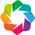

:Overlay
   .Curve.I   :Curve   [Datetime]   (PowerConsumption_Zone1)
   .Curve.II  :Curve   [Datetime]   (PowerConsumption_Zone2)
   .Curve.III :Curve   [Datetime]   (PowerConsumption_Zone3)

In [24]:
import holoviews as hv
hv.extension('bokeh')
df['Datetime'] = pd.to_datetime(df['Datetime'])

# Create HoloViews curves
curve1 = hv.Curve(df, kdims='Datetime', vdims='PowerConsumption_Zone1').opts(title='Zone 1 Consumption', color='red')
curve2 = hv.Curve(df, kdims='Datetime', vdims='PowerConsumption_Zone2').opts(title='Zone 2 Consumption', color='green')
curve3 = hv.Curve(df, kdims='Datetime', vdims='PowerConsumption_Zone3').opts(title='Zone 3 Consumption', color='blue')

# Combine them into one overlay
overlay = (curve1 * curve2 * curve3).opts(
    width=800,
    height=400,
    tools=['hover'],
    legend_position='top_left',
    xlabel='Datetime',
    ylabel='Power Consumption'
)

overlay

#  Line Plot (for time series)

In [25]:
hv.Curve(df, kdims='Datetime', vdims='PowerConsumption_Zone1').opts(title='Power Zone 1',width=900,height=500)

:Curve   [Datetime]   (PowerConsumption_Zone1)

# Overlayed Line Plot (multiple series)

In [26]:
hv.Overlay([
    hv.Curve(df, 'Datetime', 'PowerConsumption_Zone1').opts(color='red'),
    hv.Curve(df, 'Datetime', 'PowerConsumption_Zone2').opts(color='green'),
    hv.Curve(df, 'Datetime', 'PowerConsumption_Zone3').opts(color='blue')
]).opts(title='Power Consumption Over Time', width=800, height=400)


:Overlay
   .Curve.I   :Curve   [Datetime]   (PowerConsumption_Zone1)
   .Curve.II  :Curve   [Datetime]   (PowerConsumption_Zone2)
   .Curve.III :Curve   [Datetime]   (PowerConsumption_Zone3)

# Scatter Plot

In [27]:
hv.Scatter(df, 'Temperature', 'Humidity').opts(title='Temperature vs Humidity', size=5,width=1000,height=500)

:Scatter   [Temperature]   (Humidity)

# Bar Plot

In [28]:
hourly = df.copy()
hourly['Hour'] = hourly['Datetime'].dt.hour
bar = hv.Bars(hourly.groupby('Hour')['PowerConsumption_Zone1'].mean().reset_index(), 'Hour', 'PowerConsumption_Zone1').opts(title='Avg Power Zone 1 by Hour',width=1500,height=500)
bar


:Bars   [Hour]   (PowerConsumption_Zone1)

In [29]:
hv.Histogram(np.histogram(df['Temperature'], bins=20)).opts(title='Temperature Distribution',height=500,width=1500)


:Histogram   [x]   (Frequency)

# Area Plot

In [30]:
hv.Area(df, 'Datetime', 'PowerConsumption_Zone1').opts(title='Zone 1 Area Plot', alpha=0.5,width=1500,height=500)


:Area   [Datetime]   (PowerConsumption_Zone1)

# Violin Plot

In [31]:
hv.Violin(df, 'Hour', 'PowerConsumption_Zone1').opts(title='Zone 1 Violin by Hour',width=1500,height=500)


:Violin   [Hour]   (PowerConsumption_Zone1)

In [32]:
hv.Violin(df, 'Hour', 'PowerConsumption_Zone2').opts(title='Zone 2 Violin by Hour',width=1500,height=500)

:Violin   [Hour]   (PowerConsumption_Zone2)

In [33]:
hv.Violin(df, 'Hour', 'PowerConsumption_Zone3').opts(title='Zone 3 Violin by Hour',width=1500,height=500)

:Violin   [Hour]   (PowerConsumption_Zone3)

In [34]:
import panel as pn
pn.extension()

@pn.interact(zone=['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3'])
def plot_power(zone):
    return hv.Curve(df, 'Datetime', zone).opts(title=f'{zone} Over Time', width=1500,height=500)
pn.panel(plot_power).servable() 

Column(sizing_mode='fixed')
    [0] Column
        [0] Select(name='zone', options=['PowerConsumption_Zone1',...], value='PowerConsumption_Zone1')
    [1] Row(sizing_mode='fixed')
        [0] HoloViews(Curve, height=500, name='interactive02962', sizing_mode='fixed', width=1500)

In [35]:
curve = hv.Curve(df, 'Datetime', 'Temperature').opts(height=500, width=1500, title="Temperature Over Time")
scatter = hv.Scatter(df, 'Datetime', 'Humidity').opts(height=500, width=1500, title="Humidity Over Time")

(curve + scatter).cols(1)


:Layout
   .Curve.I   :Curve   [Datetime]   (Temperature)
   .Scatter.I :Scatter   [Datetime]   (Humidity)

In [36]:
df.head()

,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,Hour,DayOfWeek,Month,Date
0,2017-01-01 00:00:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386,0,6,1,2017-01-01
1,2017-01-01 00:10:00,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434,0,6,1,2017-01-01
2,2017-01-01 00:20:00,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373,0,6,1,2017-01-01
3,2017-01-01 00:30:00,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711,0,6,1,2017-01-01
4,2017-01-01 00:40:00,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964,0,6,1,2017-01-01


In [37]:
from sklearn.preprocessing import MinMaxScaler
features = ['Temperature', 'Humidity','WindSpeed', 'GeneralDiffuseFlows', 'DiffuseFlows']
labels = ['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3']
scaler_X = MinMaxScaler()
df[features] = scaler_X.fit_transform(df[features])



features = ['Hour', 'DayOfWeek', 'Month', 'Temperature', 'Humidity', 'WindSpeed', 'GeneralDiffuseFlows', 'DiffuseFlows']

from sklearn.preprocessing import MinMaxScaler

scaler_y = MinMaxScaler()
df[labels] = scaler_y.fit_transform(df[labels])



In [38]:
df.head()

,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,Hour,DayOfWeek,Month,Date
0,2017-01-01 00:00:00,0.090091,0.748382,0.005130,0.000040,0.000115,0.526251,0.262361,0.343368,0,6,1,2017-01-01
1,2017-01-01 00:10:00,0.086146,0.756770,0.005130,0.000057,0.000079,0.415545,0.374886,0.340731,0,6,1,2017-01-01
2,2017-01-01 00:20:00,0.083399,0.756770,0.004663,0.000050,0.000095,0.397623,0.362116,0.329626,0,6,1,2017-01-01
3,2017-01-01 00:30:00,0.078176,0.762761,0.005130,0.000075,0.000091,0.374149,0.339738,0.311165,0,6,1,2017-01-01
4,2017-01-01 00:40:00,0.072736,0.771148,0.004819,0.000038,0.000079,0.350834,0.322796,0.300199,0,6,1,2017-01-01


# Define features and labels

In [39]:
X = df[features].values
y = df[labels].values
print("X shape:", X.shape, "y shape:", y.shape)


X shape: (52416, 8) y shape: (52416, 3)


# Prepare LSTM sequences (6 timesteps)

In [40]:
timesteps = 24
X_seq, y_seq = [], []
for i in range(timesteps, len(X)):
    X_seq.append(X[i-timesteps:i])
    y_seq.append(y[i])
X_seq = np.array(X_seq)
y_seq = np.array(y_seq)
print("X_seq shape:", X_seq.shape, "y_seq shape:", y_seq.shape)

X_seq shape: (52392, 24, 8) y_seq shape: (52392, 3)



# Split: 70% train, 15% val, 15% test

In [41]:
X_train, X_temp, y_train, y_temp = train_test_split(X_seq, y_seq, test_size=0.30, shuffle=True)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, shuffle=False)
print("Train shapes:", X_train.shape, y_train.shape)
print("Val shapes:", X_val.shape, y_val.shape)
print("Test shapes:", X_test.shape, y_test.shape)

Train shapes: (36674, 24, 8) (36674, 3)
Val shapes: (7859, 24, 8) (7859, 3)
Test shapes: (7859, 24, 8) (7859, 3)


In [42]:
y_train_dict = {'Zone1': y_train[:, 0],'Zone2': y_train[:, 1],'Zone3': y_train[:, 2]}

y_val_dict = {'Zone1': y_val[:, 0],'Zone2': y_val[:, 1],'Zone3': y_val[:, 2]}

y_test_dict = {'Zone1': y_test[:, 0],'Zone2': y_test[:, 1],'Zone3': y_test[:, 2]}

In [43]:
with strategy.scope(): 
    input_layer = Input(shape=(X_train.shape[1], X_train.shape[2]))  
    x = Bidirectional(LSTM(64, return_sequences=True))(input_layer)  
    x = LSTM(32, return_sequences=False)(x)
    x = LayerNormalization()(x)
    x = Dense(16, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)  
    x = Dropout(0.2)(x)
    out1 = Dense(1, activation='sigmoid', name='Zone1')(x)
    out2 = Dense(1, activation='sigmoid', name='Zone2')(x)
    out3 = Dense(1, activation='sigmoid', name='Zone3')(x)
    model = Model(inputs=input_layer, outputs=[out1, out2, out3])
    model.compile(
    optimizer=Adam(learning_rate=0.0001),
    loss={'Zone1': 'mse', 'Zone2': 'mse', 'Zone3': 'mse'},
    loss_weights={'Zone1': 1.0, 'Zone2': 2.0, 'Zone3': 1.0},  
    metrics={'Zone1': 'mae', 'Zone2': 'mae', 'Zone3': 'mae'})
    model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 24, 8)     │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional       │ (None, 24, 128)   │     37,376 │ input_layer[0][0] │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_1 (LSTM)       │ (None, 32)        │     20,608 │ bidirectional[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalization │ (None, 32)        │         64 │ lstm_1[0][0]      │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 16)        │        528 │ layer_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 16)        │          0 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Zone1 (Dense)       │ (None, 1)         │         17 │ dropout[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Zone2 (Dense)       │ (None, 1)         │         17 │ dropout[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Zone3 (Dense)       │ (None, 1)         │         17 │ dropout[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 58,627 (229.01 KB)

 Trainable params: 58,627 (229.01 KB)

 Non-trainable params: 0 (0.00 B)

# Train Model

In [44]:
callbacks = [EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True),
             ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5)]

history = model.fit(X_train, y_train_dict,validation_data=(X_val, y_val_dict),batch_size=64,epochs=50,callbacks=callbacks,verbose=1)

Epoch 1/50
574/574 ━━━━━━━━━━━━━━━━━━━━ 25s 27ms/step - Zone1_loss: 0.0341 - Zone1_mae: 0.1444 - Zone2_loss: 0.0268 - Zone2_mae: 0.1258 - Zone3_loss: 0.0590 - Zone3_mae: 0.1825 - loss: 0.3530 - val_Zone1_loss: 0.0131 - val_Zone1_mae: 0.0910 - val_Zone2_loss: 0.0100 - val_Zone2_mae: 0.0777 - val_Zone3_loss: 0.0132 - val_Zone3_mae: 0.0938 - val_loss: 0.2122 - learning_rate: 1.0000e-04
Epoch 2/50
574/574 ━━━━━━━━━━━━━━━━━━━━ 15s 26ms/step - Zone1_loss: 0.0155 - Zone1_mae: 0.0968 - Zone2_loss: 0.0132 - Zone2_mae: 0.0893 - Zone3_loss: 0.0181 - Zone3_mae: 0.1039 - loss: 0.2132 - val_Zone1_loss: 0.0099 - val_Zone1_mae: 0.0769 - val_Zone2_loss: 0.0083 - val_Zone2_mae: 0.0697 - val_Zone3_loss: 0.0089 - val_Zone3_mae: 0.0778 - val_loss: 0.1529 - learning_rate: 1.0000e-04
Epoch 3/50
574/574 ━━━━━━━━━━━━━━━━━━━━ 15s 25ms/step - Zone1_loss: 0.0125 - Zone1_mae: 0.0867 - Zone2_loss: 0.0106 - Zone2_mae: 0.0799 - Zone3_loss: 0.0137 - Zone3_mae: 0.0894 - loss: 0.1548 - val_Zone1_loss: 0.0062 - val_Zone1

# Plot training & validation loss and MAE for each zone

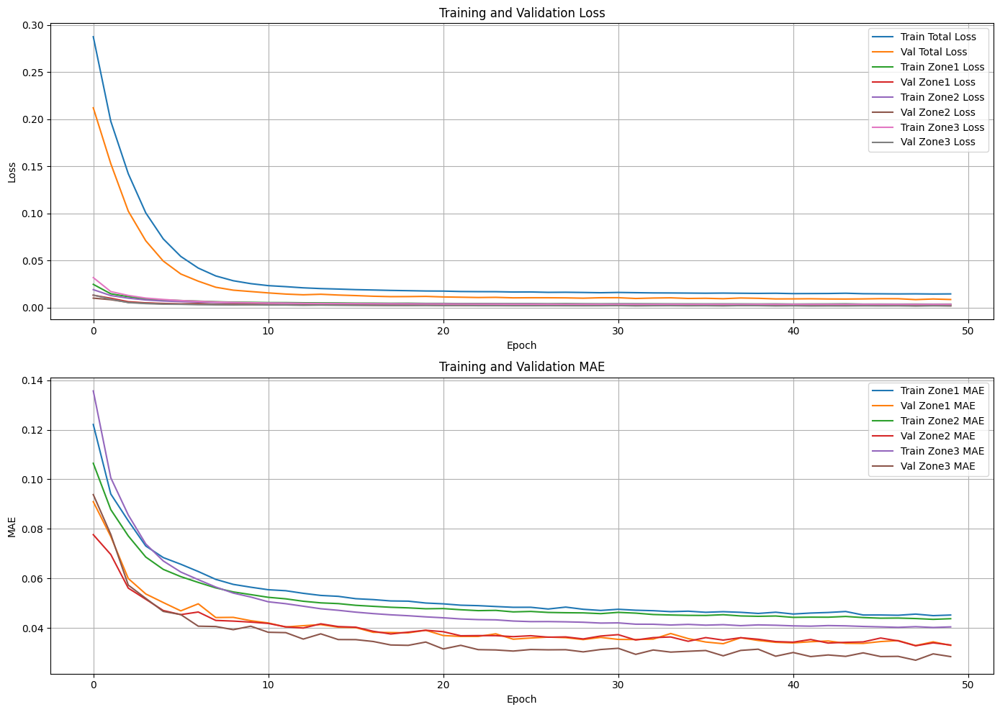

In [45]:
metrics = ['loss', 'Zone1_loss', 'Zone2_loss', 'Zone3_loss', 'val_loss', 'val_Zone1_loss', 'val_Zone2_loss', 'val_Zone3_loss',
           'Zone1_mae', 'Zone2_mae', 'Zone3_mae', 'val_Zone1_mae', 'val_Zone2_mae', 'val_Zone3_mae']

plt.figure(figsize=(14, 10))

# Plot losses
plt.subplot(2,1,1)
plt.plot(history.history['loss'], label='Train Total Loss')
plt.plot(history.history['val_loss'], label='Val Total Loss')
plt.plot(history.history['Zone1_loss'], label='Train Zone1 Loss')
plt.plot(history.history['val_Zone1_loss'], label='Val Zone1 Loss')
plt.plot(history.history['Zone2_loss'], label='Train Zone2 Loss')
plt.plot(history.history['val_Zone2_loss'], label='Val Zone2 Loss')
plt.plot(history.history['Zone3_loss'], label='Train Zone3 Loss')
plt.plot(history.history['val_Zone3_loss'], label='Val Zone3 Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

# Plot MAE
plt.subplot(2,1,2)
plt.plot(history.history['Zone1_mae'], label='Train Zone1 MAE')
plt.plot(history.history['val_Zone1_mae'], label='Val Zone1 MAE')
plt.plot(history.history['Zone2_mae'], label='Train Zone2 MAE')
plt.plot(history.history['val_Zone2_mae'], label='Val Zone2 MAE')
plt.plot(history.history['Zone3_mae'], label='Train Zone3 MAE')
plt.plot(history.history['val_Zone3_mae'], label='Val Zone3 MAE')
plt.title('Training and Validation MAE')
plt.xlabel('Epoch')
plt.ylabel('MAE')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

# Model Prediction and Performance Metrics
- Use the trained model to predict on the test set.

- Combine the predictions for all zones and invert the scaling to get original values.

- Prepare the true values array similarly by stacking the test labels and inverse transforming.

- Compute and print performance metrics — R², MAE, and RMSE — for each zone individually.

- Finally, calculate and display the overall average R² score across all zones.

## Metrics Explained:

- R² (Coefficient of Determination): Measures how well predictions approximate true values (closer to 1 is better).

- MAE (Mean Absolute Error): Average absolute difference between predictions and true values (lower is better).

- RMSE (Root Mean Squared Error): Square root of average squared differences, penalizes large errors more heavily (lower is better

In [46]:
predictions = model.predict(X_test)
y_pred_combined = np.concatenate(predictions, axis=1)
y_pred_original = scaler_y.inverse_transform(y_pred_combined)
y_test_array = np.column_stack([y_test_dict['Zone1'], y_test_dict['Zone2'], y_test_dict['Zone3']])
y_true_original = scaler_y.inverse_transform(y_test_array)



labels = ['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3']
for i, label in enumerate(labels):
    r2 = r2_score(y_true_original[:, i], y_pred_original[:, i])
    mae = mean_absolute_error(y_true_original[:, i], y_pred_original[:, i])
    rmse = np.sqrt(mean_squared_error(y_true_original[:, i], y_pred_original[:, i]))
    print(f"{label} - R²: {r2:.4f}, MAE: {mae:.2f}, RMSE: {rmse:.2f}")
avg_r2 = r2_score(y_true_original, y_pred_original, multioutput='uniform_average')
print(f"Overall Average R² Score: {avg_r2:.4f}")

246/246 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
PowerConsumption_Zone1 - R²: 0.9421, MAE: 1270.92, RMSE: 1710.98
PowerConsumption_Zone2 - R²: 0.9380, MAE: 939.47, RMSE: 1297.37
PowerConsumption_Zone3 - R²: 0.9405, MAE: 1116.61, RMSE: 1625.03
Overall Average R² Score: 0.9402


# 📊 Multi-Zone Regression Visualization Report

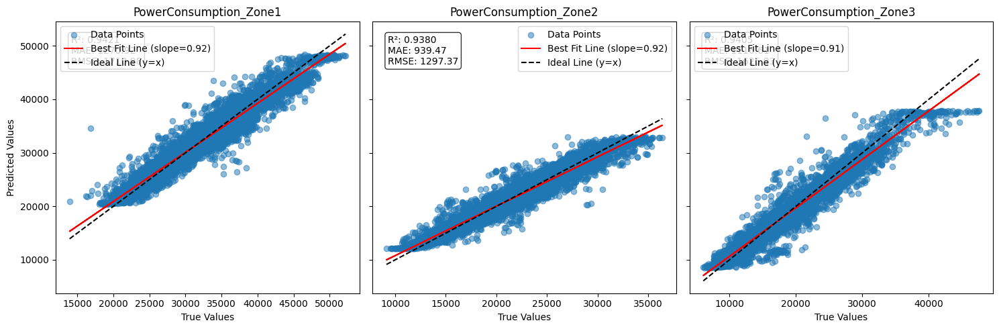

In [47]:
labels = ['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3']
fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)

for i, label in enumerate(labels):
    y_true = y_true_original[:, i]
    y_pred = y_pred_original[:, i]

    axes[i].scatter(y_true, y_pred, alpha=0.5, label='Data Points')
    slope, intercept, _, _, _ = linregress(y_true, y_pred)
    line = slope * y_true + intercept
    axes[i].plot(y_true, line, color='red', label=f'Best Fit Line (slope={slope:.2f})')
    
    min_val = min(y_true.min(), y_pred.min())
    max_val = max(y_true.max(), y_pred.max())
    axes[i].plot([min_val, max_val], [min_val, max_val], 'k--', label='Ideal Line (y=x)')

    axes[i].set_xlabel('True Values')
    axes[i].set_title(label)
    axes[i].legend()

    r2 = r2_score(y_true, y_pred)
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    axes[i].text(0.05, 0.95, f'R²: {r2:.4f}\nMAE: {mae:.2f}\nRMSE: {rmse:.2f}',
                 transform=axes[i].transAxes, fontsize=10, verticalalignment='top',
                 bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

axes[0].set_ylabel('Predicted Values')
plt.tight_layout()
plt.show()


#  Residual Plots

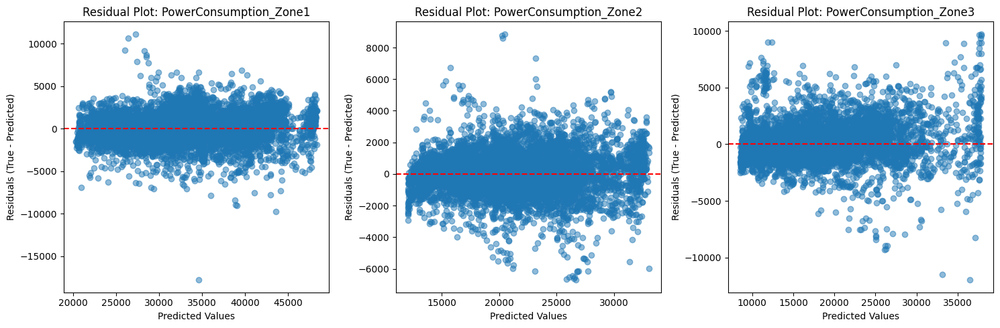

In [48]:
plt.figure(figsize=(15, 5))
for i, label in enumerate(labels):
    residuals = y_true_original[:, i] - y_pred_original[:, i]
    plt.subplot(1, 3, i+1)
    plt.scatter(y_pred_original[:, i], residuals, alpha=0.5)
    plt.axhline(0, color='red', linestyle='--')
    plt.xlabel('Predicted Values')
    plt.ylabel('Residuals (True - Predicted)')
    plt.title(f'Residual Plot: {label}')
plt.tight_layout()
plt.show()

# Time Series Plot 

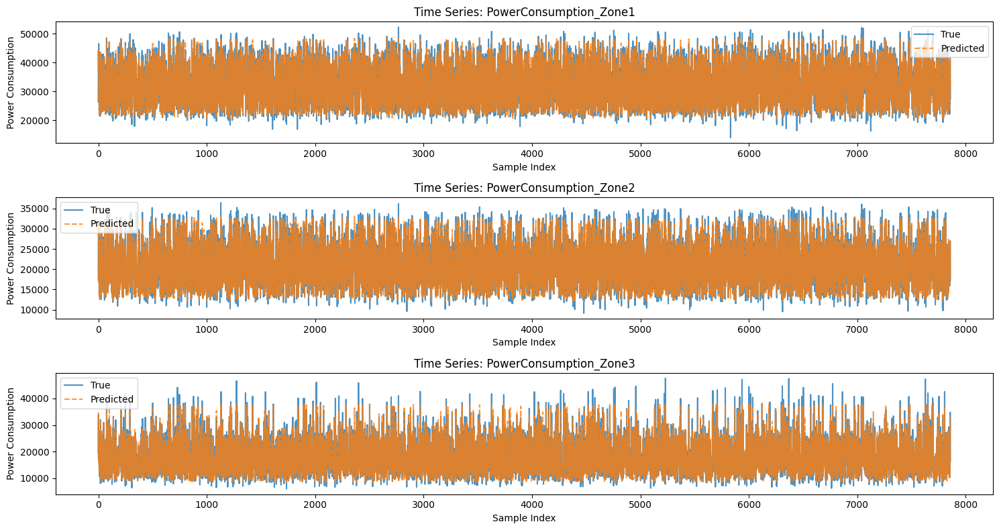

In [49]:
plt.figure(figsize=(15, 8))
for i, label in enumerate(labels):
    plt.subplot(3, 1, i+1)
    plt.plot(y_true_original[:, i], label='True', alpha=0.8)
    plt.plot(y_pred_original[:, i], label='Predicted', alpha=0.8, linestyle='--')
    plt.xlabel('Sample Index')
    plt.ylabel('Power Consumption')
    plt.title(f'Time Series: {label}')
    plt.legend()
plt.tight_layout()
plt.show()


# Histogram of Residuals

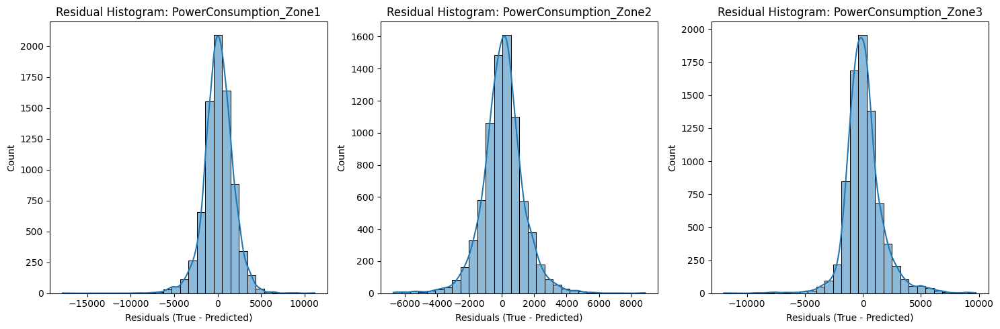

In [50]:
plt.figure(figsize=(15, 5))
for i, label in enumerate(labels):
    residuals = y_true_original[:, i] - y_pred_original[:, i]
    plt.subplot(1, 3, i+1)
    sns.histplot(residuals, bins=30, kde=True)
    plt.xlabel('Residuals (True - Predicted)')
    plt.title(f'Residual Histogram: {label}')
plt.tight_layout()
plt.show()

# Box Plot of Errors

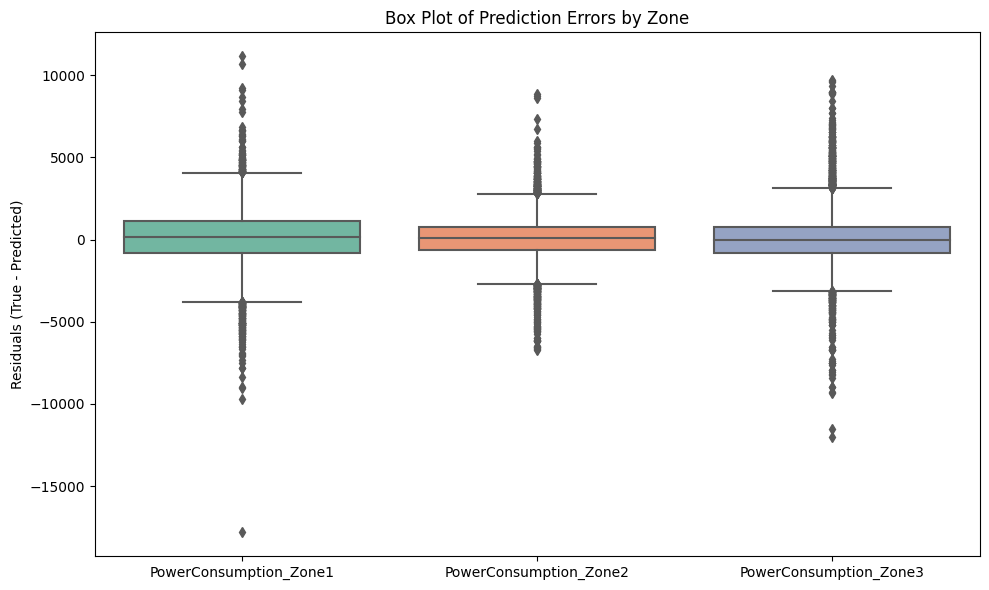

In [51]:
errors = [y_true_original[:, i] - y_pred_original[:, i] for i in range(3)]
plt.figure(figsize=(10, 6))
sns.boxplot(data=errors, palette='Set2')
plt.xticks(ticks=[0, 1, 2], labels=labels)
plt.ylabel('Residuals (True - Predicted)')
plt.title('Box Plot of Prediction Errors by Zone')
plt.tight_layout()
plt.show()

# Correlation Heatmap


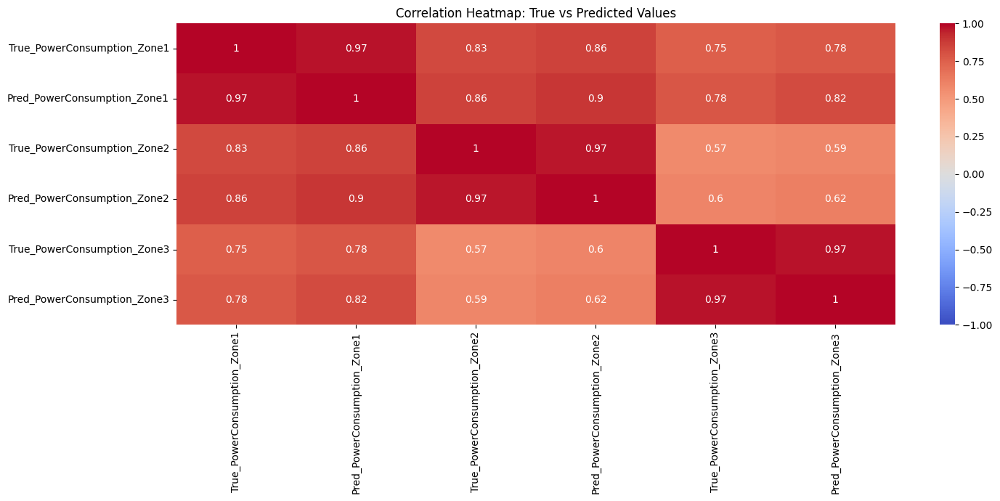

In [52]:
data_dict = {}
for i, label in enumerate(labels):
    data_dict[f'True_{label}'] = y_true_original[:, i]
    data_dict[f'Pred_{label}'] = y_pred_original[:, i]
df = pd.DataFrame(data_dict)

plt.figure(figsize=(15, 7))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Heatmap: True vs Predicted Values')
plt.tight_layout()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step

Predicted Power Consumption for Custom Samples:

Sample 1 predictions:
  PowerConsumption_Zone1: 22038.6719
  PowerConsumption_Zone2: 13758.5078
  PowerConsumption_Zone3: 13186.3281

Sample 2 predictions:
  PowerConsumption_Zone1: 29810.4277
  PowerConsumption_Zone2: 17915.9512
  PowerConsumption_Zone3: 16612.9160

Sample 3 predictions:
  PowerConsumption_Zone1: 21242.7207
  PowerConsumption_Zone2: 12402.0391
  PowerConsumption_Zone3: 11891.5625

Sample 4 predictions:
  PowerConsumption_Zone1: 23866.6699
  PowerConsumption_Zone2: 14826.2021
  PowerConsumption_Zone3: 11645.7676

Sample 5 predictions:
  PowerConsumption_Zone1: 22079.1562
  PowerConsumption_Zone2: 13610.7490
  PowerConsumption_Zone3: 10753.0391


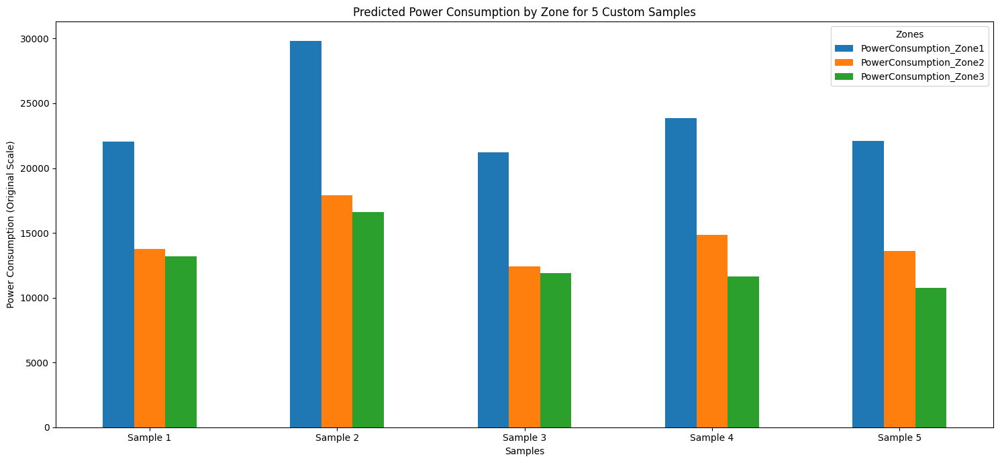

In [53]:
# Custom data as provided
custom_raw_data = np.array([
    [
        [0, 6, 1, 0.090, 0.748, 0.0051, 0.00004, 0.00011],  # timestep 1
        [0, 6, 1, 0.086, 0.756, 0.0051, 0.00005, 0.00007],  # timestep 2
        *[[0, 6, 1, 0.08, 0.75, 0.005, 0.00004, 0.00008]] * 22
    ],
    [
        [1, 2, 7, 0.10, 0.65, 0.004, 0.00007, 0.00010],
        [1, 2, 7, 0.11, 0.67, 0.0045, 0.00006, 0.00009],
        *[[1, 2, 7, 0.105, 0.66, 0.0043, 0.00005, 0.00008]] * 22
    ],
    *[
        [[2, 4, 5, 0.09, 0.70, 0.005, 0.00005, 0.00007]] * 24,
        [[3, 1, 8, 0.07, 0.80, 0.006, 0.00006, 0.00009]] * 24,
        [[4, 3, 6, 0.08, 0.72, 0.0055, 0.00007, 0.00010]] * 24
    ]
])

# Define features to scale (assuming they are columns 3 to 7)
features_to_scale = ['Temperature', 'Humidity', 'WindSpeed', 'GeneralDiffuseFlows', 'DiffuseFlows']
scale_indices = [3, 4, 5, 6, 7]  # 0-based indices for the 5 features
non_scale_indices = [i for i in range(8) if i not in scale_indices]  # Other features (0, 1, 2)

# Scale only specified features
samples, timesteps, features_count = custom_raw_data.shape
custom_scaled = custom_raw_data.copy()  # Copy to preserve original data

# Reshape to 2D for scaling only the selected features
custom_2d_to_scale = custom_raw_data[:, :, scale_indices].reshape(-1, len(scale_indices))
custom_scaled_2d = scaler_X.transform(custom_2d_to_scale)  # Scale only selected features

# Put scaled features back into the 3D array
custom_scaled[:, :, scale_indices] = custom_scaled_2d.reshape(samples, timesteps, len(scale_indices))

# Predict
y_pred_scaled = model.predict(custom_scaled)

# Concatenate if output is list
if isinstance(y_pred_scaled, list):
    y_pred_combined = np.concatenate(y_pred_scaled, axis=1)
else:
    y_pred_combined = y_pred_scaled

# Inverse transform predictions
y_pred_original = scaler_y.inverse_transform(y_pred_combined)

# Print predictions
labels = ['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3']
print("\nPredicted Power Consumption for Custom Samples:")
for i in range(samples):
    print(f"\nSample {i+1} predictions:")
    for j, zone in enumerate(labels):
        print(f"  {zone}: {y_pred_original[i, j]:.4f}")

# Create DataFrame for predictions
pred_df = pd.DataFrame(y_pred_original, columns=labels, index=[f'Sample {i+1}' for i in range(samples)])

# Bar Plot of Predictions
plt.figure(figsize=(15, 7))
pred_df.plot(kind='bar', ax=plt.gca())
plt.xlabel('Samples')
plt.ylabel('Power Consumption (Original Scale)')
plt.title('Predicted Power Consumption by Zone for 5 Custom Samples')
plt.xticks(rotation=0)
plt.legend(title='Zones')
plt.tight_layout()
plt.show()

In [54]:
model.save('my_model.keras')


In [56]:
import pickle
with open('scaler_X.pkl', 'wb') as f:
    pickle.dump(scaler_X, f)
with open('scaler_y.pkl', 'wb') as f:
    pickle.dump(scaler_y, f)

In [55]:
! pip freeze

absl-py==1.4.0
accelerate==1.8.1
aiofiles==22.1.0
aiohappyeyeballs==2.6.1
aiohttp==3.12.13
aiosignal==1.3.2
aiosqlite==0.21.0
alabaster==1.0.0
albucore==0.0.24
albumentations==2.0.8
ale-py==0.11.1
alembic==1.16.2
altair==5.5.0
annotated-types==0.7.0
annoy==1.17.3
ansicolors==1.1.8
antlr4-python3-runtime==4.9.3
anyio==4.9.0
argon2-cffi==25.1.0
argon2-cffi-bindings==21.2.0
args==0.1.0
array_record==0.7.2
arrow==1.3.0
arviz==0.21.0
astropy==7.1.0
astropy-iers-data==0.2025.6.23.0.39.50
asttokens==3.0.0
astunparse==1.6.3
atpublic==5.1
attrs==25.3.0
audioread==3.0.1
autograd==1.8.0
babel==2.17.0
backcall==0.2.0
backports.tarfile==1.2.0
bayesian-optimization==3.0.0
beartype==0.21.0
beautifulsoup4==4.13.4
betterproto==2.0.0b6
bigframes==2.8.0
bigquery-magics==0.9.0
bleach==6.2.0
blinker==1.9.0
blis==1.3.0
blobfile==3.0.0
blosc2==3.5.0
bokeh==3.7.3
Boruta==0.4.3
boto3==1.39.1
botocore==1.39.1
Bottleneck==1.4.2
-e git+https://github.com/SohierDane/BigQuery_Helper@8615a7f6c1663e7f2d48aa2b32c2dbcb